# Problema

A produtividade agrícola é um tema complexo e multifacetado, influenciado por uma ampla gama de variáveis, tanto ambientais quanto relacionadas à intervenção humana. O manejo adequado do solo, a escolha de cultivares apropriadas, a aplicação de técnicas de irrigação eficientes e o controle de pragas e doenças são apenas alguns dos fatores que podem impactar significativamente a produtividade.

# Hipótese:

Algoritmos de machine learning, como árvores de decisão, podem ser utilizados para analisar conjuntos de dados complexos e identificar as variáveis que exercem maior influência na produtividade agrícola. Ao analisar as relações entre as variáveis e a produtividade, esses algoritmos podem auxiliar na compreensão dos mecanismos subjacentes à produção agrícola e na identificação de oportunidades para otimizar o manejo e aumentar a eficiência do sistema.

## Objetivo geral

O objetivo principal desta pesquisa é identificar as principais variáveis que afetam a produtividade agrícola em um determinado contexto, utilizando técnicas de machine learning. Através da análise de dados históricos e da aplicação de modelos de previsão, pretende-se fornecer insights valiosos para embasar a tomada de decisões estratégicas no setor agrícola.

### Objetivos específicos

1. **Tratar dados:** Coletar, organizar e limpar os dados relevantes para a análise, incluindo variáveis ambientais, de manejo e de produtividade.

2. **Derivar features a partir das existentes:** Criar novas variáveis a partir das existentes, explorando diferentes combinações e transformações que possam aprimorar o poder preditivo dos modelos.

3. **Visualizar features com correlação alta para produtividade:** Analisar as correlações entre as variáveis e a produtividade, utilizando técnicas de visualização de dados como gráficos de dispersão e mapas de calor.

4. **Construir um modelo de ML para predição de produtividade:** Treinar e avaliar diferentes modelos de machine learning para prever a produtividade agrícola com base nas variáveis coletadas.

5. **Identificar principais variáveis responsáveis por afetar a produtividade:** Interpretar os resultados dos modelos de machine learning para identificar as variáveis que possuem maior impacto na produtividade agrícola.

6. **Sugerir tomadas de decisões para o negócio:** Com base nos insights obtidos, formular sugestões para otimizar o manejo agrícola e aumentar a produtividade.


# Importação de bibliotecas

In [6]:
import boto3
import os
import geopandas as gpd
import pandas as pd
from sqlalchemy import create_engine
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.offline as pyo
from dotenv import load_dotenv
import numpy as np
import seaborn as sns



pyo.init_notebook_mode()

# Configuração de variáveis

In [13]:
# Carregar as variáveis do arquivo .env
load_dotenv()

# Configurar as credenciais AWS
aws_access_key_id = os.getenv('AWS_ACCESS_KEY_ID')
aws_secret_access_key = os.getenv('AWS_SECRET_ACCESS_KEY')
region_name = os.getenv('REGION_NAME')
bucket_name = os.getenv('BUCKET_NAME')
prefix = os.getenv('PREFIX')

# Configurar as credenciais Postgres
db_user = os.getenv('DB_USER')
db_password = os.getenv('DB_PASSWORD')
db_host = os.getenv('DB_HOST')
db_port = os.getenv('DB_PORT')
db_name = os.getenv('DB_NAME')

# Inicialização de conexões

In [14]:
# Iniciar uma sessão no S3
s3 = boto3.resource('s3', 
                    aws_access_key_id=aws_access_key_id,
                    aws_secret_access_key=aws_secret_access_key,
                    region_name=region_name)

# Baixar o shapefile do S3
bucket = s3.Bucket(bucket_name)
for obj in bucket.objects.filter(Prefix=prefix):
    path, filename = os.path.split(obj.key)
    if not os.path.exists(path):
        os.makedirs(path)
    if filename != "":
        bucket.download_file(obj.key, os.path.join(path, filename))


In [51]:
# String de conexão
connection_string = f"postgresql://{db_user}:{db_password}@{db_host}:{db_port}/{db_name}"
engine = create_engine(connection_string)

# Funções

In [7]:
def read_table_corrected(table_name: str) -> pd.DataFrame:
    
    query = f"SELECT * FROM processo_seletivo.{table_name}"
    data = pd.read_sql(query, engine)
    # corrected_data = data.iloc[:, 0].str.split(';', expand=True)

    return data


def filtrar_talhao_data(df_info: pd.DataFrame, inicio: pd.Timestamp,
                        fim: pd.Timestamp, talhao: int, coluna_data_df_info: str) -> pd.DataFrame:
    
    tmp_df = df_info[(df_info[coluna_data_df_info] >= inicio) & (df_info[coluna_data_df_info] <= fim)]
    tmp_df = tmp_df[tmp_df["id_talhao"] == talhao]

    return tmp_df

def get_soma_periodo_valor(
        df_info: pd.DataFrame, inicio: pd.Timestamp,
        fim: pd.Timestamp, talhao: int, coluna_data_df_info: str,
        coluna_valor_df_info: str) -> int:
    
    tmp_df = filtrar_talhao_data(df_info, inicio, fim, talhao, coluna_data_df_info)
    valor = tmp_df[coluna_valor_df_info].sum()

    return valor

def get_media_periodo_valor(
        df_info: pd.DataFrame, inicio: pd.Timestamp,
        fim: pd.Timestamp, talhao: int, coluna_data_df_info: str,
        coluna_valor_df_info: str) -> float:
    
    tmp_df = filtrar_talhao_data(df_info, inicio, fim, talhao, coluna_data_df_info)
    valor = tmp_df[coluna_valor_df_info].mean()

    return valor

def get_max_periodo_valor(
        df_info: pd.DataFrame, inicio: pd.Timestamp,
        fim: pd.Timestamp, talhao: int, coluna_data_df_info: str,
        coluna_valor_df_info: str) -> float:
    
    tmp_df = filtrar_talhao_data(df_info, inicio, fim, talhao, coluna_data_df_info)
    valor = tmp_df[coluna_valor_df_info].max()

    return valor

def get_min_periodo_valor(
        df_info: pd.DataFrame, inicio: pd.Timestamp,
        fim: pd.Timestamp, talhao: int, coluna_data_df_info: str,
        coluna_valor_df_info: str) -> float:
    
    tmp_df = filtrar_talhao_data(df_info, inicio, fim, talhao, coluna_data_df_info)
    valor = tmp_df[coluna_valor_df_info].min()

    return valor

def get_contagem_categoria_periodo_valor(
        df_info: pd.DataFrame, inicio: pd.Timestamp,
        fim: pd.Timestamp, talhao: int, coluna_data_df_info: str,
        coluna_valor_df_info: str) -> pd.Series:
    
    tmp_df = filtrar_talhao_data(df_info, inicio, fim, talhao, coluna_data_df_info)
    serie = pd.get_dummies(tmp_df[coluna_valor_df_info]).sum()

    return serie

def set_nan_for_nat(df: pd.DataFrame, columns: list) -> pd.DataFrame:

    for column in columns:
        df[column] = df.apply(
            lambda row: np.nan if pd.isna(row['data_colheita_fim']) else row[column],
            axis=1
        )
    return df

def get_variedade(valor: str) -> str:
    
    return valor.split(" ")[2]



# Leitura dos arquivos

In [9]:
shapefile_path = 'sandbox/processo_seletivo/processo_seletivo_2024/tabela_geometria.shp'
gdf = gpd.read_file(shapefile_path)
print(gdf.head())


     fznd_nm      setr_nm cdg_tlh  \
0  Boa Vista    Anastacia      10   
1  Boa Vista  Paranatinga      11   
2  Boa Vista    Anastacia      12   
3  Boa Vista    Anastacia      13   
4  Boa Vista    Anastacia      14   

                                            geometry  
0  POLYGON ((7.06816 48.88857, 7.05142 48.86768, ...  
1  POLYGON ((7.18567 48.37687, 7.17542 48.34063, ...  
2  POLYGON ((7.05911 48.95928, 7.03710 48.97474, ...  
3  POLYGON ((7.14822 49.00547, 7.16039 49.00555, ...  
4  POLYGON ((7.15080 48.88407, 7.06816 48.88857, ...  


In [56]:
# Ler a tabela talhao
talhao_df = read_table_corrected('talhao')
meteorologia_df = read_table_corrected('meteorologia')
estadio_fenologico_df = read_table_corrected('estadio_fenologico')
aplicacao_insumo_df = read_table_corrected('aplicacao_insumo')



# talhao_df.columns = ["id_talhao","fazenda_nome","setor_nome","codigo_talhao","textura_solo_descricao",
#                      "safra_ocupacao_variedade", "periodo_safra_classe","safra_data_inicio","safra_data_fim","data_plantio_inicio",
#                      "data_plantio_fim","data_emergencia","data_colheita_inicio", "data_colheita_fim","produtividade","ultimo_estadio_fenologico"]

# meteorologia_df.columns = ["id_talhao","data_leitura","leitura_valor"]

# estadio_fenologico_df.columns = ["id_talhao","dias_apos_emergencia"]

# aplicacao_insumo_df.columns = ["id_talhao","id_insumo_aplicacao","data_aplicacao","insumo_descricao",
#                                "insumo_grupo","insumo_area_executada","aplicacao_dose_programada",
#                                "aplicacao_dose_realizada","qtde_consumido","unidade_medida","valor_dolar"]


## Checkpoint

In [23]:
# Salvando temporariamente as tabelas

# talhao_df.to_csv("talhao.csv",index=False, sep=';')
# meteorologia_df.to_csv("meteorologia.csv",index=False, sep=';')
# estadio_fenologico_df.to_csv("fenologico.csv",index=False, sep=';')
# aplicacao_insumo_df.to_csv("insumo.csv",index=False, sep=';')

In [26]:
# Carregando as tabelas salvas

talhao_df = pd.read_csv("talhao.csv", sep=';')
meteorologia_df = pd.read_csv("meteorologia.csv", sep=';')
estadio_fenologico_df = pd.read_csv("fenologico.csv", sep=';')
aplicacao_insumo_df = pd.read_csv("insumo.csv", sep=';')

# Tratamento de dados
## Talhão

In [48]:

# Datas inválidas presentes, precisei usar o coerce

talhao_df["safra_data_inicio"] = pd.to_datetime(talhao_df["safra_data_inicio"], format='%Y-%m-%d')
talhao_df["safra_data_fim"] = pd.to_datetime(talhao_df["safra_data_fim"], format='%Y-%m-%d')
talhao_df["data_plantio_inicio"] = pd.to_datetime(talhao_df["data_plantio_inicio"], format='%Y-%m-%d', errors='coerce')
talhao_df["data_plantio_fim"] = pd.to_datetime(talhao_df["data_plantio_fim"], format='%Y-%m-%d', errors='coerce')
talhao_df["data_emergencia"] = pd.to_datetime(talhao_df["data_emergencia"], format='%Y-%m-%d', errors='coerce')
talhao_df["data_colheita_inicio"] = pd.to_datetime(talhao_df["data_colheita_inicio"], format='%Y-%m-%d', errors='coerce')
talhao_df["data_colheita_fim"] = pd.to_datetime(talhao_df["data_colheita_fim"], format='%Y-%m-%d', errors='coerce')
talhao_df["produtividade"] = talhao_df["produtividade"].str.replace(',', '.').astype(float)


talhao_df.dtypes

id_talhao                             int64
fazenda_nome                         object
setor_nome                           object
codigo_talhao                         int64
textura_solo_descricao               object
safra_ocupacao_variedade             object
periodo_safra_classe                 object
safra_data_inicio            datetime64[ns]
safra_data_fim               datetime64[ns]
data_plantio_inicio          datetime64[ns]
data_plantio_fim             datetime64[ns]
data_emergencia              datetime64[ns]
data_colheita_inicio         datetime64[ns]
data_colheita_fim            datetime64[ns]
produtividade                       float64
ultimo_estadio_fenologico            object
district                             object
dtype: object

## Meteorologia

In [148]:
meteorologia_df["data_leitura"] = pd.to_datetime(meteorologia_df["data_leitura"], format='%Y-%m-%d', errors='coerce')
meteorologia_df["leitura_valor"] = pd.to_numeric(meteorologia_df["leitura_valor"])
meteorologia_df.dtypes

id_talhao                 int64
data_leitura     datetime64[ns]
leitura_valor             int64
dtype: object

## Insumo

In [80]:
aplicacao_insumo_df["data_aplicacao"] = pd.to_datetime(aplicacao_insumo_df["data_aplicacao"], format='%Y-%m-%d', errors='coerce')
aplicacao_insumo_df["insumo_area_executada"] = pd.to_numeric(aplicacao_insumo_df["insumo_area_executada"], errors='coerce')
aplicacao_insumo_df["aplicacao_dose_programada"] = pd.to_numeric(aplicacao_insumo_df["aplicacao_dose_programada"], errors='coerce')
aplicacao_insumo_df["aplicacao_dose_realizada"] = pd.to_numeric(aplicacao_insumo_df["aplicacao_dose_realizada"], errors='coerce')
aplicacao_insumo_df["qtde_consumido"] = pd.to_numeric(aplicacao_insumo_df["qtde_consumido"], errors='coerce')
aplicacao_insumo_df["valor_dolar"] = pd.to_numeric(aplicacao_insumo_df["valor_dolar"], errors='coerce')

aplicacao_insumo_df.dtypes


# Variáveis legais
# insumo_grupo
# data_aplicacao
# insumo_area_executada
# aplicacao_dose_realizada
# qtde_consumido (calcular desperdício)
# unidade_medida
# valor_dolar

id_talhao                             int64
id_insumo_aplicacao                   int64
data_aplicacao               datetime64[ns]
insumo_descricao                      int64
insumo_grupo                         object
insumo_area_executada               float64
aplicacao_dose_programada           float64
aplicacao_dose_realizada            float64
qtde_consumido                      float64
unidade_medida                       object
valor_dolar                         float64
dtype: object

## Geometria

In [62]:
gdf["cdg_tlh"] = pd.to_numeric(gdf["cdg_tlh"])

# Análise exploratória

In [62]:
talhao_df.describe()

,id_talhao,codigo_talhao,safra_data_inicio,safra_data_fim,data_plantio_inicio,data_plantio_fim,data_emergencia,data_colheita_inicio,data_colheita_fim,produtividade
count,8791.000000,8791.000000,8791,8791,8371,8417,7569,7432,7459,8791.000000
mean,19051.371858,51.165624,2018-04-04 11:03:04.688886272,2019-04-04 11:03:04.688886272,2018-08-21 03:42:35.823676928,2018-08-27 05:42:40.674824960,2019-01-12 06:09:50.725326848,2018-05-01 07:21:22.669537280,2018-05-04 07:56:50.805737728,inf
min,2054.000000,10.000000,2014-01-01 00:00:00,2015-01-01 00:00:00,2014-01-02 00:00:00,2014-01-02 00:00:00,2014-01-11 00:00:00,2014-01-02 00:00:00,2014-01-07 00:00:00,0.000000
25%,12367.500000,28.000000,2016-01-01 00:00:00,2016-12-31 00:00:00,2016-10-23 00:00:00,2016-10-26 00:00:00,2017-03-02 00:00:00,2016-07-27 12:00:00,2016-07-30 00:00:00,0.000000
50%,19642.000000,49.000000,2018-01-01 00:00:00,2019-01-01 00:00:00,2018-10-10 00:00:00,2018-10-14 00:00:00,2019-01-19 00:00:00,2018-06-07 00:00:00,2018-06-08 00:00:00,66.110884
75%,26956.500000,73.000000,2020-01-01 00:00:00,2020-12-31 00:00:00,2020-10-09 00:00:00,2020-10-12 00:00:00,2020-11-04 00:00:00,2020-03-04 00:00:00,2020-03-05 00:00:00,74.466682
max,35565.000000,99.000000,2023-01-01 00:00:00,2024-01-01 00:00:00,2022-12-31 00:00:00,2022-12-31 00:00:00,2022-12-31 00:00:00,2022-05-08 00:00:00,2022-05-16 00:00:00,inf
std,9693.686524,25.990190,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
meteorologia_df.describe()

,id_talhao,data_leitura,leitura_valor
count,2.985002e+06,2985002,2.985002e+06
mean,1.941714e+04,2018-11-11 01:56:55.993691648,5.320662e+00
min,2.054000e+03,2014-01-01 00:00:00,0.000000e+00
25%,1.319200e+04,2017-02-15 00:00:00,0.000000e+00
50%,1.988600e+04,2018-11-18 00:00:00,0.000000e+00
75%,2.689900e+04,2020-09-13 00:00:00,2.000000e+00
max,3.480800e+04,2023-01-01 00:00:00,1.600000e+02
std,9.059152e+03,NaN,1.347744e+01


In [12]:
estadio_fenologico_df.describe()

,id_talhao,dias_apos_emergencia
count,100596.000000,100294.000000
mean,18525.070699,49.661515
std,8904.257265,110.287858
min,2055.000000,-6147.000000
25%,12752.000000,24.000000
50%,19133.000000,47.000000
75%,25939.000000,74.000000
max,34081.000000,487.000000


# Feature engineering

In [63]:
# Derivando métricas

talhao_df["dias_plantio"] = (talhao_df["data_plantio_fim"] - talhao_df["data_plantio_inicio"]).dt.days
talhao_df["dias_colheita"] = (talhao_df["data_colheita_fim"] - talhao_df["data_colheita_inicio"]).dt.days
talhao_df["dias_emergencia_plantio"] = (talhao_df["data_emergencia"] - talhao_df["data_plantio_inicio"]).dt.days
talhao_df["dias_colheita_plantio"] = (talhao_df["data_colheita_fim"] - talhao_df["data_plantio_inicio"]).dt.days
talhao_df["dias_colheita_plantio"] = talhao_df["dias_colheita_plantio"].fillna(999)


In [64]:
talhao_df.head()

,id_talhao,fazenda_nome,setor_nome,codigo_talhao,textura_solo_descricao,safra_ocupacao_variedade,periodo_safra_classe,safra_data_inicio,safra_data_fim,data_plantio_inicio,data_plantio_fim,data_emergencia,data_colheita_inicio,data_colheita_fim,produtividade,ultimo_estadio_fenologico,dias_plantio,dias_colheita,dias_emergencia_plantio,dias_colheita_plantio
0,22726,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 19/20 Algod�o A2,Safrinha,2019-01-01,2020-01-01,2019-02-04,2019-02-08,2019-02-11,NaT,NaT,74.583140,Fn,4.0,NaN,7.0,999.0
1,11380,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 16/17 Soja S2,Outros,2016-01-01,2016-12-31,2016-01-28,2016-02-03,2016-02-05,2016-05-19,2016-05-21,59.068980,R6,6.0,2.0,8.0,114.0
2,23318,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 19/20 Algod�o A1,Safrinha,2019-01-01,2020-01-01,2019-02-07,2019-02-08,2019-02-11,NaT,NaT,67.319049,Fn,1.0,NaN,4.0,999.0
3,26249,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 20/21 Soja S5,Safra,2020-01-01,2020-12-31,2020-09-30,2020-10-02,2020-10-09,2020-01-21,2020-01-22,69.678215,R1,2.0,1.0,9.0,-252.0
4,3388,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 14/15 Milho M2,Safra,2014-01-01,2015-01-01,2014-11-17,2014-11-17,NaT,2014-04-19,2014-04-21,0.000000,0,0.0,2.0,NaN,-210.0


(array([4.152e+03, 3.300e+01, 9.800e+01, 2.703e+03, 3.980e+02, 1.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.406e+03]),
 array([-293. , -163.8,  -34.6,   94.6,  223.8,  353. ,  482.2,  611.4,
         740.6,  869.8,  999. ]),
 <BarContainer object of 10 artists>)

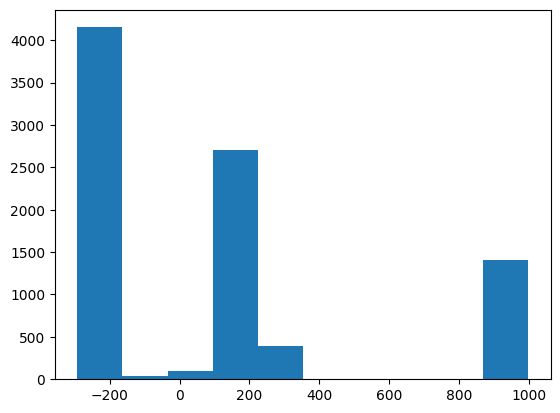

In [65]:
plt.hist(talhao_df['dias_colheita_plantio'])

# Remoção de alguns dados

Optei por remover as linhas em que a data de colheita precedia a data de plantio, pois considero que isso pode indicar um erro de registro no banco de dados. Idealmente, cada safra, seja principal ou secundária, deveria ter suas próprias entradas no banco, com datas de plantio e colheita distintas para cada uma. Isso permitiria uma identificação única para cada evento de plantio.

No momento, não consegui discernir completamente se isso se deve a uma limitação do banco de dados ou se houve alguma falha de interpretação de minha parte. Estou confiante de que, ao ingressar na empresa, terei a oportunidade de aprender com colegas mais experientes e compreender melhor a importância e o tratamento adequado dessas variáveis. Estou ansioso para contribuir de forma construtiva para a equipe, e estou aberto a orientações e aprendizados durante o processo.

In [66]:
# Checar o número de linhas antes do filtro:

print(talhao_df.shape)

# Filtrar para remover linhas onde a data de plantio acontece depois da colheita

talhao_df_dia_colheita_plantio_mq0 = talhao_df[talhao_df["dias_colheita_plantio"] >= 0]

# Checar o número de linhas depois do filtro:
print(talhao_df_dia_colheita_plantio_mq0.shape)



(8791, 20)
(4553, 20)


In [67]:
talhao_df_dia_colheita_plantio_mq0.head()

,id_talhao,fazenda_nome,setor_nome,codigo_talhao,textura_solo_descricao,safra_ocupacao_variedade,periodo_safra_classe,safra_data_inicio,safra_data_fim,data_plantio_inicio,data_plantio_fim,data_emergencia,data_colheita_inicio,data_colheita_fim,produtividade,ultimo_estadio_fenologico,dias_plantio,dias_colheita,dias_emergencia_plantio,dias_colheita_plantio
0,22726,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 19/20 Algod�o A2,Safrinha,2019-01-01,2020-01-01,2019-02-04,2019-02-08,2019-02-11,NaT,NaT,74.583140,Fn,4.0,NaN,7.0,999.0
1,11380,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 16/17 Soja S2,Outros,2016-01-01,2016-12-31,2016-01-28,2016-02-03,2016-02-05,2016-05-19,2016-05-21,59.068980,R6,6.0,2.0,8.0,114.0
2,23318,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 19/20 Algod�o A1,Safrinha,2019-01-01,2020-01-01,2019-02-07,2019-02-08,2019-02-11,NaT,NaT,67.319049,Fn,1.0,NaN,4.0,999.0
11,25927,Boa Vista,Colina 1,93,Argilosa 35%-60%,Safra 20/21 Soja S1,Safra,2020-01-01,2020-12-31,NaT,2020-10-05,2020-10-11,2020-01-25,2020-01-26,71.567958,R5.4,NaN,1.0,NaN,999.0
12,19475,Boa Vista,Colina 1,93,Argilosa 35%-60%,Safra 18/19 Milho M3,Safrinha,2018-01-01,2019-01-01,2018-03-03,2018-03-08,2018-03-08,2018-08-04,2018-08-06,92.327222,V12,5.0,2.0,5.0,156.0


In [68]:
# Considerar a produtividade NaN como 0

talhao_df_dia_colheita_plantio_mq0['produtividade'].fillna(0).value_counts()

produtividade
0.000000      1579
90.000000       20
67.459667        6
84.868330        6
79.442719        6
              ... 
60.487801        1
96.985249        1
58.132927        1
102.981839       1
66.134581        1
Name: count, Length: 2904, dtype: int64

In [ ]:
# Adicionando o total de chuva que ocorreu no período de plantio até a colheita por talhão

talhao_df_dia_colheita_plantio_mq0['soma_chuva_no_periodo'] = talhao_df_dia_colheita_plantio_mq0.apply(lambda row: get_soma_periodo_valor(
    meteorologia_df, row['data_plantio_inicio'], row['data_colheita_fim'],row['id_talhao'],
    coluna_data_df_info="data_leitura", coluna_valor_df_info="leitura_valor"), axis=1)

# Adicionando a média de chuva que ocorreu no período de plantio até a colheita por talhão

talhao_df_dia_colheita_plantio_mq0['media_chuva_no_periodo'] = talhao_df_dia_colheita_plantio_mq0.apply(lambda row: get_media_periodo_valor(
    meteorologia_df, row['data_plantio_inicio'], row['data_colheita_fim'],row['id_talhao'],
    coluna_data_df_info="data_leitura", coluna_valor_df_info="leitura_valor"), axis=1)

# Adicionando o máximo de chuva que ocorreu no período de plantio até a colheita por talhão

talhao_df_dia_colheita_plantio_mq0['max_chuva_no_periodo'] = talhao_df_dia_colheita_plantio_mq0.apply(lambda row: get_max_periodo_valor(
    meteorologia_df, row['data_plantio_inicio'], row['data_colheita_fim'],row['id_talhao'],
    coluna_data_df_info="data_leitura", coluna_valor_df_info="leitura_valor"), axis=1)

# Adicionando o mínimo de chuva que ocorreu no período de plantio até a colheita por talhão

talhao_df_dia_colheita_plantio_mq0['min_chuva_no_periodo'] = talhao_df_dia_colheita_plantio_mq0.apply(lambda row: get_min_periodo_valor(
    meteorologia_df, row['data_plantio_inicio'], row['data_colheita_fim'],row['id_talhao'],
    coluna_data_df_info="data_leitura", coluna_valor_df_info="leitura_valor"), axis=1)



In [ ]:
for nome_grupo, grupo in aplicacao_insumo_df.groupby("unidade_medida"):

    talhao_df_dia_colheita_plantio_mq0[f'soma_{nome_grupo}_insumo_aplicado_no_periodo'] = talhao_df_dia_colheita_plantio_mq0.apply(lambda row: get_soma_periodo_valor(
        grupo, row['data_plantio_inicio'], row['data_colheita_fim'],row['id_talhao'],
        coluna_data_df_info="data_aplicacao", coluna_valor_df_info="aplicacao_dose_realizada"), axis=1)
    
    talhao_df_dia_colheita_plantio_mq0[f'media_{nome_grupo}_insumo_aplicado_no_periodo'] = talhao_df_dia_colheita_plantio_mq0.apply(lambda row: get_media_periodo_valor(
        grupo, row['data_plantio_inicio'], row['data_colheita_fim'],row['id_talhao'],
        coluna_data_df_info="data_aplicacao", coluna_valor_df_info="aplicacao_dose_realizada"), axis=1)
    
    talhao_df_dia_colheita_plantio_mq0[f'max_{nome_grupo}_insumo_aplicado_no_periodo'] = talhao_df_dia_colheita_plantio_mq0.apply(lambda row: get_max_periodo_valor(
        grupo, row['data_plantio_inicio'], row['data_colheita_fim'],row['id_talhao'],
        coluna_data_df_info="data_aplicacao", coluna_valor_df_info="aplicacao_dose_realizada"), axis=1)
    
    talhao_df_dia_colheita_plantio_mq0[f'min_{nome_grupo}_insumo_aplicado_no_periodo'] = talhao_df_dia_colheita_plantio_mq0.apply(lambda row: get_min_periodo_valor(
        grupo, row['data_plantio_inicio'], row['data_colheita_fim'],row['id_talhao'],
        coluna_data_df_info="data_aplicacao", coluna_valor_df_info="aplicacao_dose_realizada"), axis=1)


In [86]:
talhao_df_dia_colheita_plantio_mq0['variedade'] = talhao_df_dia_colheita_plantio_mq0['safra_ocupacao_variedade'].apply(get_variedade)


C:\Users\Acer\AppData\Local\Temp\ipykernel_19448\4184450499.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Tratar quando o período de chuva foi 0 pois não houve data de colheita

talhao_df_dia_colheita_plantio_mq0 = set_nan_for_nat(
    talhao_df_dia_colheita_plantio_mq0, ['soma_chuva_no_periodo', 'media_chuva_no_periodo', 'max_chuva_no_periodo', 'min_chuva_no_periodo'])

colunas_insumo_novas = [coluna for coluna in talhao_df_dia_colheita_plantio_mq0 if coluna.endswith('_insumo_aplicado_no_periodo')]

# Tratar quando o período de aplicação do insumo foi 0 pois não houve data de colheita

talhao_df_dia_colheita_plantio_mq0 = set_nan_for_nat(
    talhao_df_dia_colheita_plantio_mq0, colunas_insumo_novas)

talhao_df_dia_colheita_plantio_mq0.head()

In [88]:
tmp_df = talhao_df_dia_colheita_plantio_mq0.apply(lambda row: get_contagem_categoria_periodo_valor(
    aplicacao_insumo_df, row['data_plantio_inicio'], row['data_colheita_fim'], row['id_talhao'],
    coluna_data_df_info="data_aplicacao", coluna_valor_df_info="insumo_grupo"), axis=1)

talhao_df_dia_colheita_plantio_mq0_contagem = pd.concat([talhao_df_dia_colheita_plantio_mq0, tmp_df], axis=1)

In [89]:
talhao_df_dia_colheita_plantio_mq0_contagem.head()

,id_talhao,fazenda_nome,setor_nome,codigo_talhao,textura_solo_descricao,safra_ocupacao_variedade,periodo_safra_classe,safra_data_inicio,safra_data_fim,data_plantio_inicio,...,Corretivos,Cupinicidas/Formicidas,Fertilizantes,Fungicidas,Herbicidas,Inoculantes,Inseticidas,Outros Insumos,Reguladores Crescimento,Sementes Adb Verde
0,22726,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 19/20 Algod�o A2,Safrinha,2019-01-01,2020-01-01,2019-02-04,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,11380,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 16/17 Soja S2,Outros,2016-01-01,2016-12-31,2016-01-28,...,NaN,NaN,1.0,18.0,7.0,NaN,16.0,NaN,NaN,NaN
2,23318,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 19/20 Algod�o A1,Safrinha,2019-01-01,2020-01-01,2019-02-07,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11,25927,Boa Vista,Colina 1,93,Argilosa 35%-60%,Safra 20/21 Soja S1,Safra,2020-01-01,2020-12-31,NaT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12,19475,Boa Vista,Colina 1,93,Argilosa 35%-60%,Safra 18/19 Milho M3,Safrinha,2018-01-01,2019-01-01,2018-03-03,...,NaN,NaN,2.0,1.0,4.0,NaN,3.0,NaN,NaN,NaN


In [90]:
dummies = pd.get_dummies(talhao_df_dia_colheita_plantio_mq0_contagem[["textura_solo_descricao", "periodo_safra_classe",
                                                                      "ultimo_estadio_fenologico", "variedade"]])
talhao_df_com_dummies = pd.concat([talhao_df_dia_colheita_plantio_mq0_contagem, dummies], axis=1)


In [91]:
talhao_df_com_dummies.head()

,id_talhao,fazenda_nome,setor_nome,codigo_talhao,textura_solo_descricao,safra_ocupacao_variedade,periodo_safra_classe,safra_data_inicio,safra_data_fim,data_plantio_inicio,...,ultimo_estadio_fenologico_V7,ultimo_estadio_fenologico_V8,ultimo_estadio_fenologico_V9,ultimo_estadio_fenologico_VC,ultimo_estadio_fenologico_VE,ultimo_estadio_fenologico_VN,ultimo_estadio_fenologico_VT,variedade_Algod�o,variedade_Milho,variedade_Soja
0,22726,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 19/20 Algod�o A2,Safrinha,2019-01-01,2020-01-01,2019-02-04,...,False,False,False,False,False,False,False,True,False,False
1,11380,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 16/17 Soja S2,Outros,2016-01-01,2016-12-31,2016-01-28,...,False,False,False,False,False,False,False,False,False,True
2,23318,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 19/20 Algod�o A1,Safrinha,2019-01-01,2020-01-01,2019-02-07,...,False,False,False,False,False,False,False,True,False,False
11,25927,Boa Vista,Colina 1,93,Argilosa 35%-60%,Safra 20/21 Soja S1,Safra,2020-01-01,2020-12-31,NaT,...,False,False,False,False,False,False,False,False,False,True
12,19475,Boa Vista,Colina 1,93,Argilosa 35%-60%,Safra 18/19 Milho M3,Safrinha,2018-01-01,2019-01-01,2018-03-03,...,False,False,False,False,False,False,False,False,True,False


## Geometria

In [165]:
if gdf.crs.is_geographic:
    # Reprojetar para um sistema de coordenadas apropriado (exemplo: UTM zone 23S, EPSG:32723)
    gdf = gdf.to_crs(epsg=32723)
    print("CRS após reprojeção:", gdf.crs)


# Calcular a área dos polígonos em hectares
gdf['area_ha'] = gdf.geometry.area / 10000
# Exibir as áreas calculadas
gdf.head()

,fznd_nm,setr_nm,cdg_tlh,geometry,area_ha
0,Boa Vista,Anastacia,10,"POLYGON ((4169332.853 16853814.329, 4170189.59...",8455.152755
1,Boa Vista,Paranatinga,11,"POLYGON ((4222955.424 16812912.991, 4225596.72...",7703.316894
2,Boa Vista,Anastacia,12,"POLYGON ((4162383.052 16859878.608, 4159632.91...",7820.216315
3,Boa Vista,Anastacia,13,"POLYGON ((4163672.631 16869494.450, 4164411.59...",8187.488595
4,Boa Vista,Anastacia,14,"POLYGON ((4174829.875 16858325.959, 4169332.85...",8800.410767


## Junção da tabela talhão modificada com a de geometrias

In [167]:
talhao_df_com_dummies.dtypes

id_talhao                        int64
fazenda_nome                    object
setor_nome                      object
codigo_talhao                    int64
textura_solo_descricao          object
                                 ...  
ultimo_estadio_fenologico_VN      bool
ultimo_estadio_fenologico_VT      bool
variedade_Algod�o                 bool
variedade_Milho                   bool
variedade_Soja                    bool
Length: 143, dtype: object

In [170]:
gdf.dtypes

fznd_nm       object
setr_nm       object
cdg_tlh        int64
geometry    geometry
area_ha      float64
dtype: object

In [192]:
talhao_df_com_dummies.shape

(4553, 143)

In [194]:
df_talhao_geo = pd.merge(talhao_df_com_dummies, gdf,  how='left',
left_on=['fazenda_nome','setor_nome', 'codigo_talhao'],
right_on = ['fznd_nm','setr_nm', 'cdg_tlh'])


In [195]:
df_talhao_geo.shape

(4553, 148)

In [196]:
df_talhao_geo.head()

,id_talhao,fazenda_nome,setor_nome,codigo_talhao,textura_solo_descricao,safra_ocupacao_variedade,periodo_safra_classe,safra_data_inicio,safra_data_fim,data_plantio_inicio,...,ultimo_estadio_fenologico_VN,ultimo_estadio_fenologico_VT,variedade_Algod�o,variedade_Milho,variedade_Soja,fznd_nm,setr_nm,cdg_tlh,geometry,area_ha
0,22726,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 19/20 Algod�o A2,Safrinha,2019-01-01,2020-01-01,2019-02-04,...,False,False,True,False,False,Boa Vista,Colina 1,92.0,"POLYGON ((4215882.490 16903217.789, 4213452.25...",7393.722303
1,11380,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 16/17 Soja S2,Outros,2016-01-01,2016-12-31,2016-01-28,...,False,False,False,False,True,Boa Vista,Colina 1,92.0,"POLYGON ((4215882.490 16903217.789, 4213452.25...",7393.722303
2,23318,Boa Vista,Colina 1,92,Muito Argilosa 60%-100%,Safra 19/20 Algod�o A1,Safrinha,2019-01-01,2020-01-01,2019-02-07,...,False,False,True,False,False,Boa Vista,Colina 1,92.0,"POLYGON ((4215882.490 16903217.789, 4213452.25...",7393.722303
3,25927,Boa Vista,Colina 1,93,Argilosa 35%-60%,Safra 20/21 Soja S1,Safra,2020-01-01,2020-12-31,NaT,...,False,False,False,False,True,Boa Vista,Colina 1,93.0,"POLYGON ((4232371.424 16900548.967, 4238228.49...",8102.042144
4,19475,Boa Vista,Colina 1,93,Argilosa 35%-60%,Safra 18/19 Milho M3,Safrinha,2018-01-01,2019-01-01,2018-03-03,...,False,False,False,True,False,Boa Vista,Colina 1,93.0,"POLYGON ((4232371.424 16900548.967, 4238228.49...",8102.042144


In [220]:
abt = df_talhao_geo[[
"produtividade",
"dias_plantio",
"dias_colheita",
"dias_emergencia_plantio",
"dias_colheita_plantio",
"soma_chuva_no_periodo",
"media_chuva_no_periodo",
"max_chuva_no_periodo",
"min_chuva_no_periodo",
"soma_Grama_insumo_aplicado_no_periodo",
"media_Grama_insumo_aplicado_no_periodo",
"max_Grama_insumo_aplicado_no_periodo",
"min_Grama_insumo_aplicado_no_periodo",
"soma_Litros_insumo_aplicado_no_periodo",
"media_Litros_insumo_aplicado_no_periodo",
"max_Litros_insumo_aplicado_no_periodo",
"min_Litros_insumo_aplicado_no_periodo",
"soma_Metro_insumo_aplicado_no_periodo",
"media_Metro_insumo_aplicado_no_periodo",
"max_Metro_insumo_aplicado_no_periodo",
"min_Metro_insumo_aplicado_no_periodo",
"soma_Pe�as_insumo_aplicado_no_periodo",
"media_Pe�as_insumo_aplicado_no_periodo",
"max_Pe�as_insumo_aplicado_no_periodo",
"min_Pe�as_insumo_aplicado_no_periodo",
"soma_Quilograma_insumo_aplicado_no_periodo",
"media_Quilograma_insumo_aplicado_no_periodo",
"max_Quilograma_insumo_aplicado_no_periodo",
"min_Quilograma_insumo_aplicado_no_periodo",
"soma_Sacas_insumo_aplicado_no_periodo",
"media_Sacas_insumo_aplicado_no_periodo",
"max_Sacas_insumo_aplicado_no_periodo",
"min_Sacas_insumo_aplicado_no_periodo",
"soma_Unidade_insumo_aplicado_no_periodo",
"media_Unidade_insumo_aplicado_no_periodo",
"max_Unidade_insumo_aplicado_no_periodo",
"min_Unidade_insumo_aplicado_no_periodo",
"Acaricidas",
"Adjuvantes",
"Adubo Foliar",
"Bactericidas",
"Corretivos",
"Cupinicidas/Formicidas",
"Fertilizantes",
"Fungicidas",
"Herbicidas",
"Inoculantes",
"Inseticidas",
"Outros Insumos",
"Reguladores Crescimento",
"Sementes Adb Verde",
"textura_solo_descricao_0",
"textura_solo_descricao_Arenosa 0%-15%",
"textura_solo_descricao_Argilosa 35%-60%",
"textura_solo_descricao_Media 15%-35%",
"textura_solo_descricao_Muito Argilosa 60%-100%",
"periodo_safra_classe_Outros",
"periodo_safra_classe_Safra",
"periodo_safra_classe_Safrinha",
"ultimo_estadio_fenologico_0",
"ultimo_estadio_fenologico_At� 10 Folhas",
"ultimo_estadio_fenologico_At� 12 FOLHAS",
"ultimo_estadio_fenologico_At� 2 Folhas",
"ultimo_estadio_fenologico_At� 6 Folhas",
"ultimo_estadio_fenologico_At� 8 Folhas",
"ultimo_estadio_fenologico_B1",
"ultimo_estadio_fenologico_B3",
"ultimo_estadio_fenologico_Bn",
"ultimo_estadio_fenologico_C1",
"ultimo_estadio_fenologico_C2",
"ultimo_estadio_fenologico_C3",
"ultimo_estadio_fenologico_C4",
"ultimo_estadio_fenologico_C5",
"ultimo_estadio_fenologico_C6",
"ultimo_estadio_fenologico_Cn",
"ultimo_estadio_fenologico_F1",
"ultimo_estadio_fenologico_F2",
"ultimo_estadio_fenologico_F3",
"ultimo_estadio_fenologico_F4",
"ultimo_estadio_fenologico_F5",
"ultimo_estadio_fenologico_F6",
"ultimo_estadio_fenologico_F7",
"ultimo_estadio_fenologico_FC",
"ultimo_estadio_fenologico_Fn",
"ultimo_estadio_fenologico_R1",
"ultimo_estadio_fenologico_R2",
"ultimo_estadio_fenologico_R3",
"ultimo_estadio_fenologico_R4",
"ultimo_estadio_fenologico_R5",
"ultimo_estadio_fenologico_R5.1",
"ultimo_estadio_fenologico_R5.2",
"ultimo_estadio_fenologico_R5.3",
"ultimo_estadio_fenologico_R5.4",
"ultimo_estadio_fenologico_R5.5",
"ultimo_estadio_fenologico_R6",
"ultimo_estadio_fenologico_R7",
"ultimo_estadio_fenologico_R7.1",
"ultimo_estadio_fenologico_R7.2",
"ultimo_estadio_fenologico_R7.3",
"ultimo_estadio_fenologico_R8",
"ultimo_estadio_fenologico_R8.1",
"ultimo_estadio_fenologico_R8.2",
"ultimo_estadio_fenologico_R9",
"ultimo_estadio_fenologico_V1",
"ultimo_estadio_fenologico_V10",
"ultimo_estadio_fenologico_V11",
"ultimo_estadio_fenologico_V12",
"ultimo_estadio_fenologico_V13",
"ultimo_estadio_fenologico_V15",
"ultimo_estadio_fenologico_V16",
"ultimo_estadio_fenologico_V17",
"ultimo_estadio_fenologico_V18",
"ultimo_estadio_fenologico_V2",
"ultimo_estadio_fenologico_V3",
"ultimo_estadio_fenologico_V4",
"ultimo_estadio_fenologico_V5",
"ultimo_estadio_fenologico_V6",
"ultimo_estadio_fenologico_V7",
"ultimo_estadio_fenologico_V8",
"ultimo_estadio_fenologico_V9",
"ultimo_estadio_fenologico_VC",
"ultimo_estadio_fenologico_VE",
"ultimo_estadio_fenologico_VN",
"ultimo_estadio_fenologico_VT",
"variedade_Algod�o",
"variedade_Milho",
"variedade_Soja",
"area_ha",
]]

# Checkpoint abt

In [ ]:
# abt.to_csv("abt.csv",sep=';', index=False)

In [8]:
abt = pd.read_csv("abt.csv",sep=';')

In [9]:
abt.head()

,produtividade,dias_plantio,dias_colheita,dias_emergencia_plantio,dias_colheita_plantio,soma_chuva_no_periodo,media_chuva_no_periodo,max_chuva_no_periodo,min_chuva_no_periodo,soma_Grama_insumo_aplicado_no_periodo,...,ultimo_estadio_fenologico_V8,ultimo_estadio_fenologico_V9,ultimo_estadio_fenologico_VC,ultimo_estadio_fenologico_VE,ultimo_estadio_fenologico_VN,ultimo_estadio_fenologico_VT,variedade_Algod�o,variedade_Milho,variedade_Soja,area_ha
0,74.583140,4.0,NaN,7.0,999.0,NaN,NaN,NaN,NaN,NaN,...,False,False,False,False,False,False,True,False,False,7393.722303
1,59.068980,6.0,2.0,8.0,114.0,952.0,8.278261,70.0,0.0,0.0,...,False,False,False,False,False,False,False,False,True,7393.722303
2,67.319049,1.0,NaN,4.0,999.0,NaN,NaN,NaN,NaN,NaN,...,False,False,False,False,False,False,True,False,False,7393.722303
3,71.567958,NaN,1.0,NaN,999.0,0.0,NaN,NaN,NaN,0.0,...,False,False,False,False,False,False,False,False,True,8102.042144
4,92.327222,5.0,2.0,5.0,156.0,1388.0,8.897436,120.0,0.0,0.0,...,False,False,False,False,False,False,False,True,False,8102.042144


In [205]:
corr = abt.corr()

corr.to_csv('correlacao_abt.csv',sep=';')

corr_notna = corr[corr['produtividade'].notna()]
corr_maior_20 = corr_notna[(corr_notna['produtividade'] >= 0.10) | (corr_notna['produtividade'] <= -0.10)]
corr_maior_20 = corr_maior_20.sort_values("produtividade")
corr_para_plot = corr_maior_20.drop("produtividade")


In [203]:
corr_para_plot

,produtividade,dias_plantio,dias_colheita,dias_emergencia_plantio,dias_colheita_plantio,soma_chuva_no_periodo,media_chuva_no_periodo,max_chuva_no_periodo,min_chuva_no_periodo,soma_Grama_insumo_aplicado_no_periodo,...,ultimo_estadio_fenologico_V8,ultimo_estadio_fenologico_V9,ultimo_estadio_fenologico_VC,ultimo_estadio_fenologico_VE,ultimo_estadio_fenologico_VN,ultimo_estadio_fenologico_VT,variedade_Algod�o,variedade_Milho,variedade_Soja,area_ha
Sementes Adb Verde,-0.674222,0.278092,-0.322663,0.245350,-0.168327,0.522056,0.851188,0.960678,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.177477
media_chuva_no_periodo,-0.440070,0.010215,-0.154279,-0.016266,-0.111201,0.327566,1.000000,0.180617,0.381426,-0.010576,...,0.005526,0.003059,0.000764,-0.026134,-0.016116,-0.017402,-0.056832,0.070035,-0.042334,-0.084751
dias_colheita_plantio,-0.439061,-0.079570,0.293169,-0.126191,1.000000,-0.164436,-0.111201,0.158506,-0.079325,-0.014756,...,-0.072931,-0.066270,0.009165,-0.028172,-0.014414,-0.010292,0.272425,-0.465424,0.342520,0.067410
ultimo_estadio_fenologico_0,-0.384046,-0.008789,-0.107079,-0.032839,0.162059,-0.154622,0.215151,-0.092826,0.040275,-0.003758,...,-0.151931,-0.125061,-0.068181,-0.086647,-0.027789,-0.022687,-0.209883,0.134436,0.116876,0.041275
max_Grama_insumo_aplicado_no_periodo,-0.290026,-0.233802,-0.138913,-0.877618,-0.227355,0.348220,-0.050856,-0.810664,NaN,0.645127,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.228739,0.228739,-0.374883
periodo_safra_classe_Safra,-0.286598,-0.158219,-0.027753,-0.321666,0.413371,-0.305822,-0.061655,-0.117434,0.002701,-0.006466,...,-0.041708,-0.025900,0.013780,0.009871,-0.008598,-0.007019,-0.112162,-0.307048,0.706111,0.000783
media_Grama_insumo_aplicado_no_periodo,-0.286446,-0.230654,-0.137727,-0.864198,-0.245054,0.334195,-0.075414,-0.811427,NaN,0.632519,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.243156,0.243156,-0.374883
variedade_Soja,-0.283337,0.015586,-0.037806,0.022846,0.342520,-0.368004,-0.042334,-0.096544,0.012471,0.096444,...,-0.040137,-0.024394,0.015306,-0.025989,-0.008335,-0.006805,-0.249274,-0.347278,1.000000,-0.034354
min_Grama_insumo_aplicado_no_periodo,-0.282703,-0.227372,-0.136469,-0.850137,-0.262856,0.319865,-0.100127,-0.811697,NaN,0.619497,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.257639,0.257639,-0.374883
Inseticidas,-0.215621,0.126819,0.431270,0.089954,0.698597,0.473199,0.003638,0.046107,0.095656,0.001349,...,-0.109059,-0.095630,-0.041397,0.045194,0.025629,0.015293,0.880817,-0.875627,0.028118,0.035279


# Análise de correlação das variáveis derivadas com a produtividade:

Com essa análise, podemos compreender preliminarmente como cada variável se correlaciona com a variável resposta produtividade de forma univariada.

C:\Users\Acer\AppData\Local\Temp\ipykernel_19448\388076380.py:13: UserWarning:

FixedFormatter should only be used together with FixedLocator



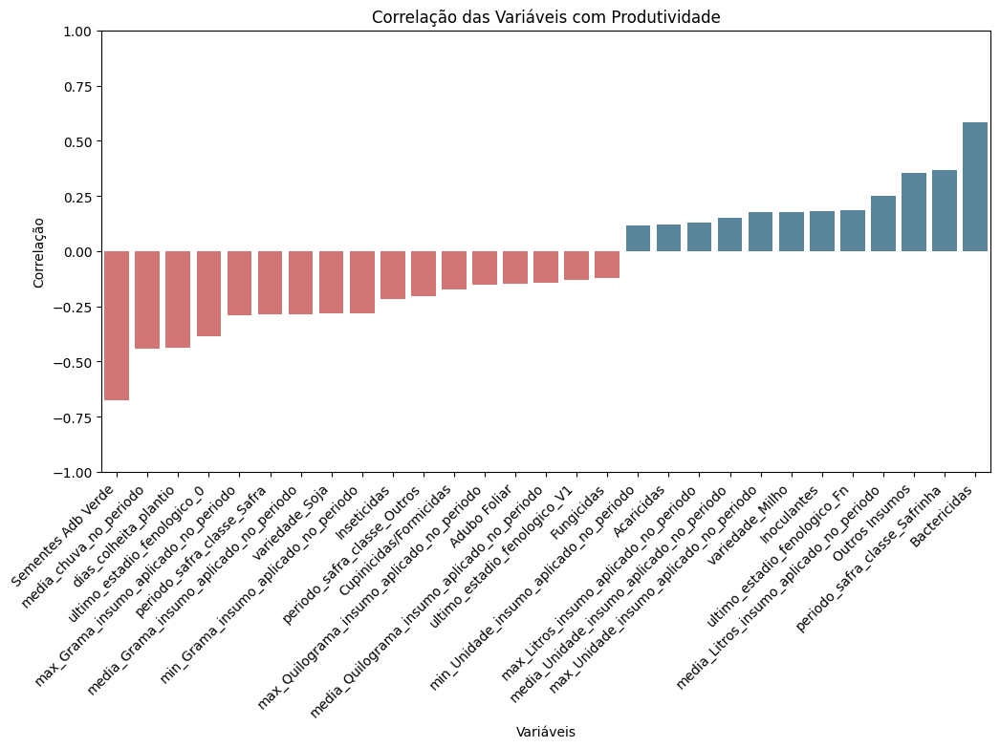

In [204]:
# Ajustar o tamanho da figura
plt.figure(figsize=(12, 6))

palette ={"negativa": "#e06666", "positiva": "#4e88a4"}

# Criar uma coluna 'cor' com base na correlação
corr_para_plot['cor'] = ['negativa' if x < 0 else 'positiva' for x in corr_para_plot['produtividade']]

# Criar o gráfico de barras com seaborn e definir a cor com base na correlação
ax = sns.barplot(x=corr_para_plot.index, y='produtividade', data=corr_para_plot, hue='cor', palette=palette, legend=False)

# Inclinar o nome das variáveis em 45 graus
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

# Definir os limites do eixo y entre -1 e 1
plt.ylim(-1, 1)

# Adicionar rótulos e título
plt.xlabel('Variáveis')
plt.ylabel('Correlação')
plt.title('Correlação das Variáveis com Produtividade')

# Exibir o gráfico
plt.show()

# Modelagem

In [10]:
# Tratamento da abt

abt = abt.replace([np.inf, -np.inf], np.nan)
abt = abt.dropna(subset=['produtividade'])



In [13]:
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor


y = abt['produtividade']

X = abt.drop(['produtividade'], axis=1)



In [14]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, random_state=0, test_size=0.20)


In [259]:
# Defining the parameters you want to test
parameters = {'nthread':[4], #when use hyperthread, xgboost may become slower
              'learning_rate': [.03, 0.05, .07], #so called `eta` value
              'max_depth': [5, 6, 7],
              'min_child_weight': [4],
              'silent': [1],
              'subsample': [0.7],
              'colsample_bytree': [0.7],
              'n_estimators': [500]}


# Creating a GridSearchCV object
grid_search = GridSearchCV(XGBRegressor(), parameters, scoring='neg_root_mean_squared_error', cv=5, verbose=1, n_jobs=-1)

# Running the grid search
grid_search.fit(X_train, y_train)


print(grid_search.best_score_)
print(grid_search.best_params_)

Fitting 5 folds for each of 9 candidates, totalling 45 fits


d:\.pyspark-env\lib\site-packages\xgboost\core.py:160: UserWarning:

[13:06:34] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0b3782d1791676daf-1\xgboost\xgboost-ci-windows\src\learner.cc:742: 
Parameters: { "silent" } are not used.




-13.386570151486055
{'colsample_bytree': 0.7, 'learning_rate': 0.05, 'max_depth': 7, 'min_child_weight': 4, 'n_estimators': 500, 'nthread': 4, 'silent': 1, 'subsample': 0.7}


In [15]:
# Melhor modelo
model = XGBRegressor(colsample_bytree=0.7, learning_rate=0.05, max_depth=7,
                     min_child_weight=4, n_estimators=500, nthread=4, subsample=0.7)

# Supondo que X_train e y_train são os seus dados de treinamento
model.fit(X_train, y_train)

# Fazendo previsões
y_pred_gb = model.predict(X_test)

# Calculando o MSE e RMSE
mse = mean_squared_error(y_test, y_pred_gb)
rmse = np.sqrt(mse)

print(f'MSE {mse}')
print(f'RMSE {rmse}')

MSE 180.3149420684659
RMSE 13.428139933306694


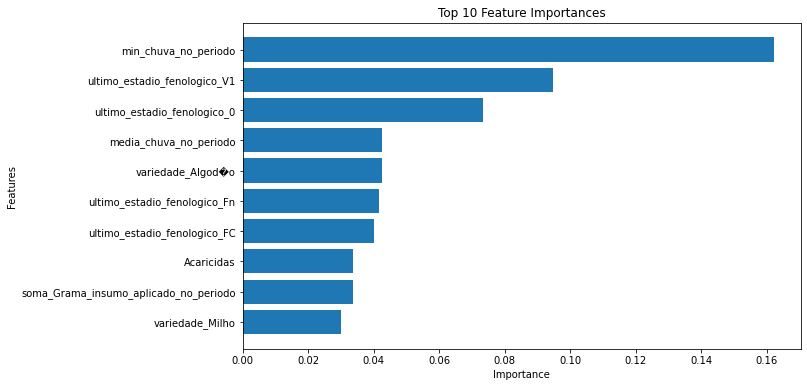

In [27]:
# Checando a importância das variáveis
feature_importances = model.feature_importances_
feature_names = [f'{i}' for i in X.columns]

# Selecionando as 10 variáveis mais importantes
indices = np.argsort(feature_importances)[-10:]  # Índices das 10 mais importantes
top_features = np.array(feature_names)[indices]
top_importances = feature_importances[indices]

# Plotando as 10 variáveis mais importantes
plt.figure(figsize=(10, 6))
plt.barh(top_features, top_importances)
plt.xlabel('Importance')
plt.ylabel('Features')
plt.title('Top 10 Feature Importances')
plt.show()

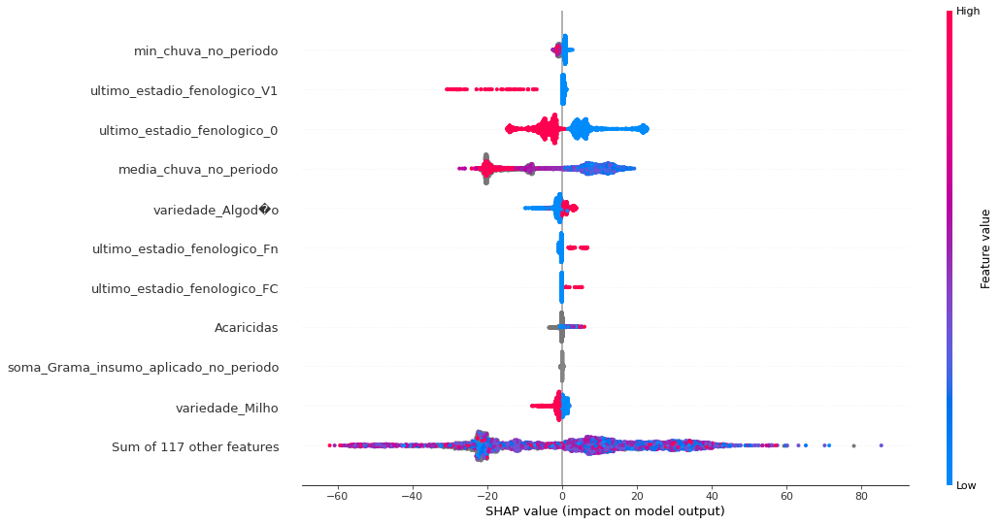

In [82]:
import shap
indices = np.argsort(feature_importances)[::-1]
top_features = np.array(feature_names)[indices]

# Usar SHAP para calcular os valores SHAP
explainer = shap.Explainer(model)
shap_values = explainer(X)



fig = shap.plots.beeswarm(shap_values, order=indices, max_display=11, plot_size=[14,9], show=False)


plt.savefig('shap_summary_plot.png', dpi=300)


# Análise espacial

In [57]:
import pyproj


shapefile_path = 'sandbox/processo_seletivo/processo_seletivo_2024/tabela_geometria.shp'
gdf = gpd.read_file(shapefile_path)
gdf["cdg_tlh"] = pd.to_numeric(gdf["cdg_tlh"])
# gdf.to_crs(pyproj.CRS.from_epsg(4326), inplace=True)
gdf.head()

,fznd_nm,setr_nm,cdg_tlh,geometry
0,Boa Vista,Anastacia,10,"POLYGON ((7.06816 48.88857, 7.05142 48.86768, ..."
1,Boa Vista,Paranatinga,11,"POLYGON ((7.18567 48.37687, 7.17542 48.34063, ..."
2,Boa Vista,Anastacia,12,"POLYGON ((7.05911 48.95928, 7.03710 48.97474, ..."
3,Boa Vista,Anastacia,13,"POLYGON ((7.14822 49.00547, 7.16039 49.00555, ..."
4,Boa Vista,Anastacia,14,"POLYGON ((7.15080 48.88407, 7.06816 48.88857, ..."


In [58]:
gdf["district"] = gdf["fznd_nm"] + " " + gdf["setr_nm"] + " " + gdf["cdg_tlh"].astype(str) 

talhao_df["district"] = talhao_df["fazenda_nome"] + " " + talhao_df["setor_nome"] + " " + talhao_df["codigo_talhao"].astype(str)

geo_df = gdf.merge(talhao_df, on="district").set_index("district")

In [65]:
geo_df.head()

,fznd_nm,setr_nm,cdg_tlh,geometry,id_talhao,fazenda_nome,setor_nome,codigo_talhao,textura_solo_descricao,safra_ocupacao_variedade,...,safra_data_inicio,safra_data_fim,data_plantio_inicio,data_plantio_fim,data_emergencia,data_colheita_inicio,data_colheita_fim,produtividade,ultimo_estadio_fenologico,variedade
district,,,,,,,,,,,,,,,,,,,,,
Boa Vista Anastacia 10,Boa Vista,Anastacia,10,"POLYGON ((7.06816 48.88857, 7.05142 48.86768, ...",29635,Boa Vista,Anastacia,10,Muito Argilosa 60%-100%,Safra 21/22 Soja S5,...,2021-01-01,2022-01-01,2021-09-19,2021-09-19,2021-09-25,2021-01-08,2021-01-09,57.238142,R6,Soja
Boa Vista Anastacia 10,Boa Vista,Anastacia,10,"POLYGON ((7.06816 48.88857, 7.05142 48.86768, ...",22665,Boa Vista,Anastacia,10,Muito Argilosa 60%-100%,Safra 19/20 Algod�o A2,...,2019-01-01,2020-01-01,2019-01-25,2019-01-25,2019-01-30,NaT,NaT,75.623022,Cn,Algod�o
Boa Vista Anastacia 10,Boa Vista,Anastacia,10,"POLYGON ((7.06816 48.88857, 7.05142 48.86768, ...",21191,Boa Vista,Anastacia,10,Muito Argilosa 60%-100%,Safra 19/20 Soja S3,...,2019-01-01,2020-01-01,2019-09-24,2019-09-28,2019-09-30,2019-01-24,2019-01-25,73.532151,R7.2,Soja
Boa Vista Anastacia 10,Boa Vista,Anastacia,10,"POLYGON ((7.06816 48.88857, 7.05142 48.86768, ...",4109,Boa Vista,Anastacia,10,Muito Argilosa 60%-100%,Safra 15/16 Soja S6,...,2015-01-01,2016-01-01,2015-10-11,2015-10-12,2015-10-19,2015-01-31,2015-02-02,0.000000,R7.1,Soja
Boa Vista Anastacia 10,Boa Vista,Anastacia,10,"POLYGON ((7.06816 48.88857, 7.05142 48.86768, ...",15303,Boa Vista,Anastacia,10,Muito Argilosa 60%-100%,Safra 17/18 Algod�o A2,...,2017-01-01,2018-01-01,2017-01-20,2017-01-21,2017-01-28,2017-08-31,2017-10-17,80.364060,C2,Algod�o


## Mapas de produtividade

In [68]:
for nome_fazenda, df_fazenda in geo_df.groupby('fznd_nm'):

    fig = px.choropleth(
        df_fazenda,
        geojson=df_fazenda.geometry,
        locations=df_fazenda.index,  # Usando o campo 'id' criado como identificador
        color="produtividade",
        hover_name='setr_nm',
        title=f'Mapa de Produtividade {nome_fazenda}',
        range_color=[0, 100]  # Definir a escala de cor entre 0 e 100
    )

    fig.update_geos(
        visible=False,
        showcountries=False,
        showsubunits=True,
        showframe=False,
        fitbounds="locations"  # Ajustar a exibição ao seu GeoDataFrame
    )

    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

    print(nome_fazenda)

    fig.show()

Boa Vista


Cachoeira


Felicidade


Floresta Azul


Repouso


In [63]:
fig = px.choropleth(geo_df,
                   geojson=geo_df.geometry,
                   locations=geo_df.index,
                   color="produtividade",
                   projection="mercator",
                   range_color=[0, 100]),



# Serie temporal de meteorologia

In [155]:
meteorologia_df['data_leitura'] = pd.to_datetime(meteorologia_df['data_leitura'])

meteorologia_df_agrupado = meteorologia_df.groupby(['data_leitura'])[['leitura_valor']].sum()

meteorologia_df_agrupado.head()


,leitura_valor
data_leitura,
2014-01-01,2935
2014-01-04,1746
2014-01-05,279
2014-01-06,456
2014-01-11,1490


In [156]:
meteorologia_df_agrupado.describe()

,leitura_valor
count,3246.000000
mean,4892.848737
std,7157.704859
min,0.000000
25%,0.000000
50%,1782.500000
75%,7119.000000
max,58242.000000


Text(0.5, 1.0, 'Leitura de chuva')

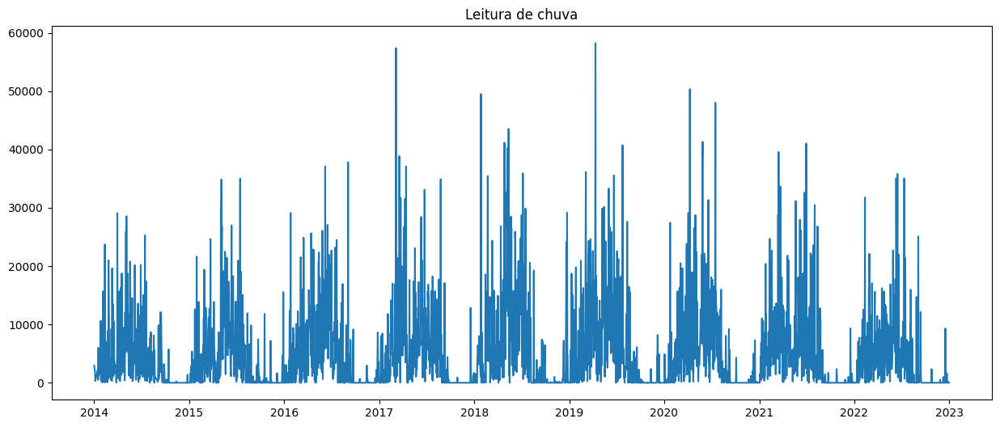

In [157]:
plt.figure(figsize=(15,6))
plt.plot(meteorologia_df_agrupado['leitura_valor'])
plt.title("Leitura de chuva")

In [159]:
meteorologia_df_agrupado = meteorologia_df_agrupado.asfreq('D')

In [160]:
meteorologia_df_agrupado.index

DatetimeIndex(['2014-01-01', '2014-01-02', '2014-01-03', '2014-01-04',
               '2014-01-05', '2014-01-06', '2014-01-07', '2014-01-08',
               '2014-01-09', '2014-01-10',
               ...
               '2022-12-23', '2022-12-24', '2022-12-25', '2022-12-26',
               '2022-12-27', '2022-12-28', '2022-12-29', '2022-12-30',
               '2022-12-31', '2023-01-01'],
              dtype='datetime64[ns]', name='data_leitura', length=3288, freq='D')

In [179]:
from statsmodels.tsa.seasonal import seasonal_decompose

meteorologia_df_agrupado.sort_index(inplace=True)

data = meteorologia_df_agrupado['leitura_valor']

data = data.dropna()

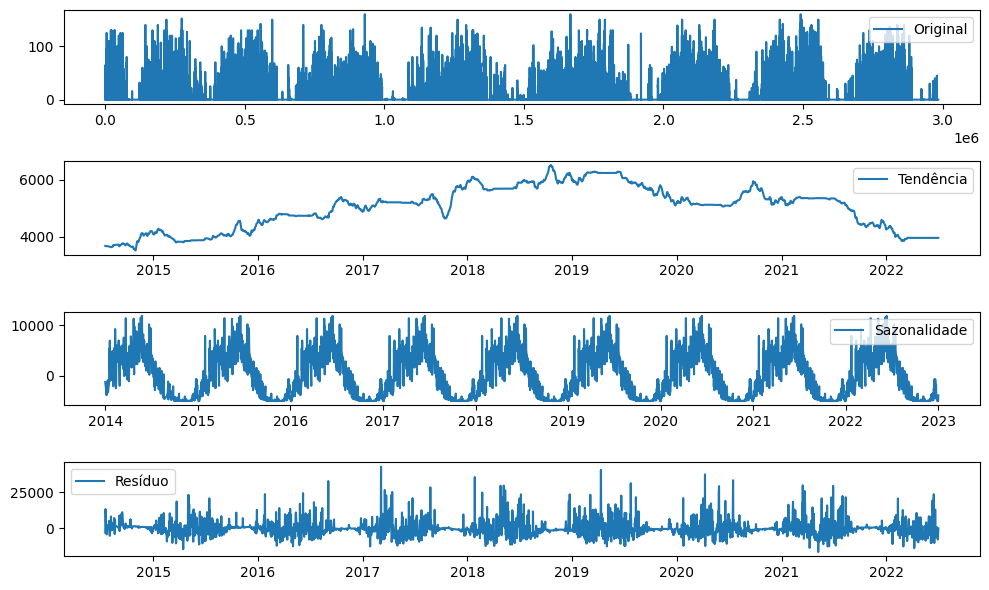

In [177]:
# Realizar a decomposição da série temporal
decomposition = seasonal_decompose(data, model = 'additive', period=364)

# Extrair as componentes de tendência, sazonalidade e resíduo
trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid

# Plotar as componentes
plt.figure(figsize=(10, 6))

plt.subplot(411)
plt.plot(meteorologia_df['leitura_valor'], label='Original')
plt.legend(loc='best')

plt.subplot(412)
plt.plot(trend, label='Tendência')
plt.legend(loc='best')

plt.subplot(413)
plt.plot(seasonal, label='Sazonalidade')
plt.legend(loc='best')

plt.subplot(414)
plt.plot(residual, label='Resíduo')
plt.legend(loc='best')

plt.tight_layout()
plt.show()
